In [2]:
# Importacion.
from scipy.io import wavfile
import IPython
import os
import numpy as np
import matplotlib.pyplot as plt
import wave
import subprocess


# Directorios que usaremos.
cwd = os.getcwd()
audio_input_path = os.path.join(cwd, os.path.join('audio', '_input'))  # audio_examples
audio_output_path = os.path.join(cwd, os.path.join('audio', '_output'))
print(f'Path to input audio: {audio_input_path}')
print(f'Path to output audio: {audio_output_path}\n')

Path to input audio: /home/apazg7/Universidad/SistemasMultimedia/Practica3_SM/audio/_input
Path to output audio: /home/apazg7/Universidad/SistemasMultimedia/Practica3_SM/audio/_output



In [3]:
# Cargamos el archivo de audio.
filename = os.path.join(audio_input_path, 'sample1_stereo.wav')
sample_rate, audio_data = wavfile.read(filename)
print('Datos del audio (estereo):')
print(f'Frecuencia de muestreo (sample rate): {sample_rate/1000} kHz')
print(f'Número de canales: {audio_data.shape[1]}')
print(f'Número de muestras : {audio_data.shape[0]}')
print(f"El tamaño del archivo es: {subprocess.check_output(['ls', '-sh', 'audio/_input/sample_48kHz.wav']).decode('utf-8').split()[0]}B")


Datos del audio (estereo):
Frecuencia de muestreo (sample rate): 44.1 kHz
Número de canales: 2
Número de muestras : 5384326
El tamaño del archivo es: 348KB


In [5]:
# Incluir un widget para reproducir el audio
IPython.display.Audio(audio_data.T, rate=sample_rate) # .T se pasa únicamente si es audio estéreo.

## Conversion de audio estereo a mono


In [7]:
# Conversión del audio a mono
audio_mono = audio_data.mean(axis=1)
print('Datos del audio (mono):')
print(f'Frecuencia de muestreo (sample rate): {sample_rate/1000} kHz')
print(f'Número de muestras y número de canales (es 1): {audio_mono.shape}')
print(f"El tamaño del archivo es: {subprocess.check_output(['ls', '-sh', 'audio/_input/sample_48kHz.wav']).decode('utf-8').split()[0]}B")

Datos del audio (mono):
Frecuencia de muestreo (sample rate): 44.1 kHz
Número de muestras y número de canales (es 1): (5384326,)
El tamaño del archivo es: 348KB


In [8]:
IPython.display.Audio(audio_mono, rate=sample_rate)

### **Diferencias entre el sonido mono y el estereo**
La principal diferencia es que el sonido mono se reproduce a traves de un solo canal, mientras que el estereo se reproduce a traves de 2 canales.

### **¿Qúe es la frecuencia de muestreo?**
La frecuencia de muestreo es la cantidad de veces por segundo que se toma una muestra de la señal analógica de audio para su conversión a una señal digital.
Por ejemplo, una frecuencia de muestreo de 44.1 kHz significa que se están tomando 44,100 muestras de la señal analógica por segundo para convertirla en una señal digital.

## Grafica en dominio del tiempo

In [9]:
num_m_estereo = len(audio_data)
print(f'Número de muestras del audio estereo: {num_m_estereo}')

num_m_mono = len(audio_mono)
print(f'Número de muestras del audio mono: {num_m_mono}')

sample_est, audio_est = wavfile.read(filename=os.path.join(audio_input_path, 'sample_48kHz.wav'))
sample_mono, audio_mono = wavfile.read(filename=os.path.join(audio_input_path, 'sample_24kHz.wav'))


Número de muestras del audio estereo: 5384326
Número de muestras del audio mono: 5384326


In [10]:
# Para escuchar estos audios hacemos lo siguiente.
IPython.display.Audio(audio_est, rate=sample_est)

In [11]:
IPython.display.Audio(audio_mono, rate=sample_mono)

In [12]:
ampl_values_48 = len(audio_est)
print(f'Número de muestras del archivo (valores de amplitud): {ampl_values_48}')

Número de muestras del archivo (valores de amplitud): 176542


In [13]:
ampl_values_24 = len(audio_mono)
print(f'Número de muestras del archivo (valores de amplitud): {ampl_values_24}')

Número de muestras del archivo (valores de amplitud): 88271


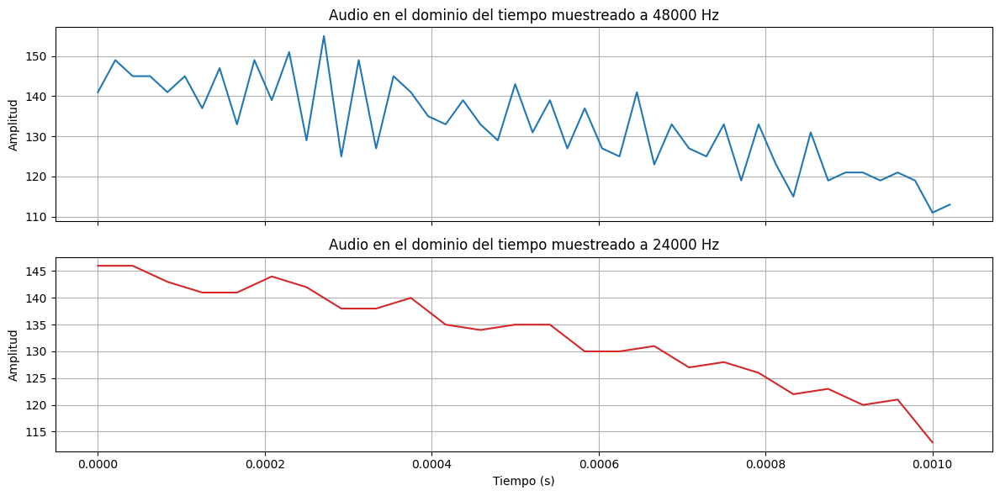

In [14]:
# Valor inicial: 0
# Valor final: muestras/frecuencia de muestreo
# Incremento: 1/frecuencia de muestreo
t1 = np.arange(0, ampl_values_48/sample_est, 1/sample_est)
t2 = np.arange(0, ampl_values_24/sample_mono, 1/sample_mono)

# Mostrar gráfica.
fig, ax = plt.subplots(2, 1, figsize=(12, 6), sharex=True)
ratio = sample_est / sample_mono
end = 50

ax[0].plot(t1[:end], audio_est[:end])
ax[0].set_title(f'Audio en el dominio del tiempo muestreado a {sample_est} Hz')
ax[0].set_ylabel('Amplitud')
ax[0].grid(True)

ax[1].plot(t2[:int(end/ratio)], audio_mono[:int(end/ratio)], c='tab:red')
ax[1].set_title(f'Audio en el dominio del tiempo muestreado a {sample_mono} Hz')
ax[1].set_xlabel('Tiempo (s)')
ax[1].set_ylabel('Amplitud')
ax[1].grid(True)

plt.tight_layout()
plt.show()